# Analyzing property taxes in Berkeley

In [2]:
from datascience import *
import pandas as pd
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
import numpy as np
import requests
import time

## Data cleaning + setup

Let's start by grabbing a dataset from the city of Berkeley that contains data on the taxable square footage of the properties in Berkeley. The reason this dataset is important is not the property tax data; what is important is that it contains all of the properties in Berkeley, with their street name and street number (with which we can find their latitude and longitude for visualizations) and with their APN (with which we can query for property tax data).

In [2]:
# dataset from https://data.cityofberkeley.info/City-Government/Taxable-Square-Footage/9a47-nj4i
berkeley_properties = Table.read_table('berkeley-taxable-square-footage-data.csv')
berkeley_properties

APN,STRNBR,STRDIRECT,STRNAME,STRAPART,STRFRACT,BLDSQFTTAXABLE
016 141000101,3101,nan,BENVENUE AVE,nan,nan,1055
016 141001501,6432,nan,BENVENUE AVE,nan,nan,0
016 141001801,6414,nan,BENVENUE AVE,nan,nan,0
016 141002201,2607,nan,ALCATRAZ AVE,nan,nan,837
016 141003200,6420,nan,BENVENUE AVE,COM,nan,0
016 141404300,2400,nan,WOOLSEY ST,nan,nan,1000
016 141404400,2412,nan,WOOLSEY ST,nan,nan,169
016 141404600,2418,nan,WOOLSEY ST,nan,nan,450
016 141404800,2420,nan,WOOLSEY ST,nan,nan,500
016 141405000,3100,nan,COLBY ST,nan,nan,0


For future use, we will add a more readable version of the `STRNAME` column called `addr:street`.

In [3]:
# derived from the source code of the dropdown list on https://www.acgov.org/ptax_pub_app/RealSearch.do
street_type_mapping = {
    'ALY': 'Alley',
    'AVE': 'Avenue',
    'BAY': 'Bay',
    'BLVD': 'Boulevard',
    'CIR': 'Circle',
    'CMN': 'Common',
    'CT': 'Court',
    'CV': 'Cove',
    'CRES': 'Crescent',
    'CRST': 'Crest',
    'DR': 'Drive',
    'FWY': 'Freeway',
    'GLN': 'Glen',
    'HL': 'Hill',
    'HLS': 'Hills',
    'HWY': 'Highway',
    'LN': 'Lane',
    'LOOP': 'Loop',
    'MALL': 'Mall',
    'PARK': 'Park',
    'PKWY': 'Parkway',
    'PATH': 'Path',
    'PL': 'Place',
    'PLZ': 'Plaza',
    'PT': 'Point',
    'RD': 'Road',
    'SQ': 'Square',
    'ST': 'Street',
    'TER': 'Terrace',
    'TRL': 'Trail',
    'VIS': 'Vista',
    'WALK': 'Walk',
    'WAY': 'Way'
}

def make_more_readable(STRNAME):
    if STRNAME == 'M L KING JR WAY':
        return 'Martin Luther King Jr Way'
    parts = STRNAME.split()
    last_part = parts[len(parts) - 1]
    if last_part in street_type_mapping:
        parts[len(parts) - 1] = street_type_mapping[last_part]
    for i in range(len(parts)):
        current_part = parts[i].lower()
        parts[i] = current_part[0].upper() + current_part[1:]
    return ' '.join(parts)

berkeley_properties = berkeley_properties.with_columns(
    'addr:street',
    berkeley_properties.apply(make_more_readable, 'STRNAME')
)

We should also find each property's latitude and longitude so that we can plot the properties on a map for visualizing data. I got the `berkeley_osm_buildings.csv` by running the following two queries through https://overpass-turbo.eu/ and concatenating the resulting CSVs:

```
[out:csv(::lat, ::lon, "addr:housenumber", "addr:street")][timeout:25];
node["addr:housenumber"]["addr:street"]({{bbox}});
out body;
```
---
```
[out:csv(::lat, ::lon, "addr:housenumber", "addr:street")][timeout:25];
way["addr:housenumber"]["addr:street"]({{bbox}});
out center;
```

In [4]:
berkeley_osm_buildings = Table.read_table('berkeley-osm-buildings.csv', sep='\t')

# Some properties have a street name of 'Martin Luther King Junior Way' instead of 'Martin Luther King Jr Way'
def change_mlk_junior_way(street_name):
    if street_name == 'Martin Luther King Junior Way':
        return 'Martin Luther King Jr Way'
    else:
        return street_name

berkeley_osm_buildings = berkeley_osm_buildings.with_columns('addr:street', berkeley_osm_buildings.apply(change_mlk_junior_way, 'addr:street'))

# turn STRNBR into strings for joining (addr:street in the berkeley_osm_ways column is an array of strings)
berkeley_properties = berkeley_properties.with_column('STRNBR', berkeley_properties.apply(lambda num: str(num), 'STRNBR'))

# Join into the berkeley_properties table
berkeley_properties = berkeley_properties.join(['STRNBR', 'addr:street'], berkeley_osm_buildings, ['addr:housenumber', 'addr:street'])
berkeley_properties

STRNBR,addr:street,APN,STRDIRECT,STRNAME,STRAPART,STRFRACT,BLDSQFTTAXABLE,@lat,@lon
1,Ajax Place,060 249501901,nan,AJAX PL,nan,nan,3136,37.8881,-122.25
1,Alvarado Road,064 422601200,nan,ALVARADO RD,nan,nan,3474,37.8558,-122.24
1,Arcade Avenue,060 248601000,nan,ARCADE AVE,nan,nan,1496,37.8866,-122.252
1,Atlas Place,060 249501001,nan,ATLAS PL,nan,nan,3602,37.8874,-122.25
1,Avenida Drive,060 248203800,nan,AVENIDA DR,nan,nan,1815,37.8829,-122.252
1,Bolivar Drive,060 252100201,nan,BOLIVAR DR,nan,nan,0,37.8665,-122.303
1,Brookside Avenue,064 429500100,nan,BROOKSIDE AVE,nan,nan,3499,37.853,-122.249
1,Claremont Crescent,052 156505600,nan,CLAREMONT CRES,nan,nan,2069,37.8578,-122.247
1,Columbia Circle,060 248502100,nan,COLUMBIA CIR,nan,nan,2144,37.8853,-122.252
1,El Camino Real,064 424100100,nan,EL CAMINO REAL,nan,nan,4984,37.8572,-122.243


Next, let's define a function that allows us to find the "total taxable value" of a property in Berkeley by its APN from the table above. We'll also define a function that allows us to find a property's property tax bill for 2021-2022 by its APN.

In [5]:
def parse_apn(apn):
    main_part = apn[1:4].rstrip() + '-' + apn[4:8] + '-' + str(int(apn[8:11]))
    last_part = apn[11:13]
    if last_part == '00':
        return main_part
    else:
        return main_part + '-' + str(int(last_part))

# using this tool: http://www.acgov.org/MS/prop/index.aspx
def find_ttv_for_property_with_apn(apn):
    payload = {
        '__VIEWSTATE': '/wEPDwULLTE1Nzc3MjYxNzdkZMdwWtI1eXO+hvXJRS5J2hSeTLaCZ341SgyzFwLWJCgk',
        '__EVENTVALIDATION': '/wEdAD2FuSOj69YzeebI09eV8BgNZpmhYRDZkx9tBeUijD4tyFgbubSQzt87uhdk/LewFfmZsvbn4DyI62OBAuyKi2y+RV+/VKkuUcpRJh/vzaqJBkxCNW9GddN571/lKM55Ef8v6CHXMlrtC+sEymLwrNSptzOF2jhByPhKO6llsJ1c63HqR45X43LY4iAM15o/dhwaMnmncxSVNfp0fNdMMLgwOwSOKW+e4g/lnjO6IBN/BzrtTexOWbJcCkUwrs9lmDezYjFlYQMYeAsnkW20PoerdfTkTdmeoukF5QoSGexxFQGeUsS8Y47fCESqhwofgcKoh/0WuC/8WGJa2f62/RMYaKh8cLDzPs0M232hWdz1jOCPhxDQznKsOaE9p82RHXH0pubZnKl07nXqhOTVTXOnJAakmmakiUJZtdmuChU8A5hPztU1XVF6NBnqOrdpL4/YgJotwivmUdc3bMtG0lXlaAv+MRYoplUqkgRoKKLltDj66sBy6G+I4mbXAF46K8/JgidHJw4a6s0jr4PkjVimvxlJdbxjfdeK9VhvwdBfQxw8Hun6qWzzyPxM7+NPZPbrfi9deVfnDHauYsUks6Z4bzOaCVkhjnucz6wi2hOaNpFDCuwQ7r9GpNW7R/y+QyA9v6lV3qRKLPSkVbdQzUdA7i/MEkvwPnV44a/TlR/p991gXyK8Sv92AENteWS/ke79b6kwjB9y8OfWK9tfTMHJuqFi/8tH/Jq0mzYsORjBPAabUmuS66ODq21NKay/4nUwlgeCPI+VDOSlDIGKBlkZTZkysBbyClqfe6n56nyPjPbA8XDnCvxozkQZB95/SFC/9/aZB6q+BjnJvW1xhXB/pFP7x6cepEISUMEKLUHxwX9vnsF7O+E09z676CjY5yNAY9IyJgvIomA5UYSV3hxsHijEB7V7lIOa+sh3lQGvNzkO+OtbKac13XhblJ4N77x968dNrH8Zhd7CxFEOQKbsi/gvzUu6F9E6DOtaDGVkuTRAiOY6Zn7ETUzMAQr/IHCDBfbIwWIS0UkGvDgb9NjYcKI2BAj3b1WWsxUkYR+xoEHTPKPjsLfB4s/XSItBJKa5F0jGbEhQozb+UopDgHbhb05KXCb40P+pYNgXYc/iGsYwrqYBdKcB7o+ipliee+lF/jVK4GoJwOfjOU+64/W3Li01MVSRQxHkVAwDk+MCMyuv3o0rQ0RJzXnXoewzF6y0KmEodNE6U/4DZfaBp1S3lbaT+ZBOJhUdY9t0O+aUjb8N2LnyL92xDpoudgkhQGY85pbWlDO2hADfoPXD/5tdOOmtil/2lP4XVuRES/XZ4PsCXWU25Gf/TAzYE0YgVfA=',
        'txtParcelNum': parse_apn(apn),
        'ddlbCity': 'BERKELEY',
        'btnSubmit': 'Submit'
    }
    
    try:
        r = requests.post('http://www.acgov.org/MS/prop/index.aspx', data=payload)
        ttv_text_index = r.text.index('Total Taxable Value', 11500) # all that I have tested lie above 11500
        ttv_tag_index = r.text.index('span id="FormView1_roll_tot_tax_label" class="desc2" style="display:inline-block;">', ttv_text_index)
        start_of_ttv_index = r.text.index('>', ttv_tag_index) + 1
        end_of_ttv_index = r.text.index('<', start_of_ttv_index)
        return float(r.text[start_of_ttv_index:end_of_ttv_index].replace('$', '').replace(',', ''))
    except ValueError as err:
        print('find_ttv_for_property_with_apn ValueError', err)
        return

# using this tool: https://www.acgov.org/ptax_pub_app/RealSearch.do
def find_21_22_bill(apn):
    payload = {
        'displayApn': parse_apn(apn),
        'situsCity': 'BERKELEY',
        'searchBills': 'Search',
        'showHistory': 'N'
    }
    
    try:
        r = requests.post('https://www.acgov.org/ptax_pub_app/RealSearch.do', data=payload)
        year_index = r.text.index('2021-2022', 14000) # all that I have tested lie above 14000
        amount_index = r.text.index('$', year_index) + 1
        end_of_amount_index = r.text.index('<', amount_index)
        return float(r.text[amount_index:end_of_amount_index].replace(',', ''))
    except ValueError as err:
        print('find_21_22_bill ValueError', err)
        return

## Observing the correlation between TTV (total taxable value) and 2021/2022 property tax bills

Unfortunately, the `find_ttv_for_property_with_apn` function is quite slow (about 0.2 seconds per property) and the `find_21_22_bill` function is even slower (about 0.5 seconds per property). Because of this, we want to use the `find_ttv_for_property_apn` function because it is faster. Let's see if there is a correlation between the total taxable value of a property and its 2021/2022 property tax bill in a small sample.

In [6]:
# for consistency, we will use the same sample every time we run the notebook
# the sample in the file below was collected using the commented out code

small_sample_of_properties = Table.read_table('small_sample_of_properties.csv').drop(0)
# small_sample_of_properties = berkeley_properties.sample(100, with_replacement=False)

In [7]:
start = time.time()
# to save time, we will use TTV and property tax bills we calculated previously
# the sample in the file below was collected using the commented out code

some_bpts_with_ttv_and_ptax_bill = Table.read_table('some_bpts_with_ttv_and_ptax_bill.csv').drop(0)
#some_bpts_with_ttv_and_ptax_bill = small_sample_of_properties.with_columns(
#    'Total Taxable Value',
#    small_sample_of_properties.apply(find_ttv_for_property_with_apn, 'APN'),
#    '2021/2022 Property Tax Bill',
#    small_sample_of_properties.apply(find_21_22_bill, 'APN')
#)
end = time.time()
print(f'It took {end - start} seconds to process {some_bpts_with_ttv_and_ptax_bill.num_rows} properties.')
print(f'{(end - start) / some_bpts_with_ttv_and_ptax_bill.num_rows} seconds per property, on average.')
some_bpts_with_ttv_and_ptax_bill

It took 0.0077342987060546875 seconds to process 100 properties.
7.734298706054687e-05 seconds per property, on average.


STRNBR,addr:street,APN,STRDIRECT,STRNAME,STRAPART,STRFRACT,BLDSQFTTAXABLE,@lat,@lon,Total Taxable Value,2021/2022 Property Tax Bill
20,Mosswood Road,055 186204905,nan,MOSSWOOD RD,nan,nan,1876,37.87,-122.248,1.50054e+06,21745.4
2426,Grant Street,055 190601200,nan,GRANT ST,nan,nan,5148,37.8638,-122.275,961175,20216.4
3053,Dohr Street,053 161501800,nan,DOHR ST,nan,nan,3546,37.8514,-122.28,613383,13607.6
2104,Derby Street,054 171900200,nan,DERBY ST,nan,nan,1796,37.8602,-122.266,300915,7083.74
2400,Sacramento Street,056 191903800,nan,SACRAMENTO ST,nan,nan,736,37.8638,-122.282,33975,2375.82
150,Bret Harte Road,063 298500701,nan,BRET HARTE RD,nan,nan,3574,37.8899,-122.259,2.06113e+06,31338.3
1342,Haskell Street,052 151603300,nan,HASKELL ST,nan,nan,2357,37.8513,-122.282,1.00624e+06,16236.4
1772,Walnut Street,058 217701100,nan,WALNUT ST,nan,nan,1508,37.8753,-122.268,351070,6860.88
2921,Hillegass Avenue,052 156902100,nan,HILLEGASS AVE,nan,nan,2382,37.8574,-122.255,317409,8705.26
2430,Fifth Street,056 194403700,nan,FIFTH ST,L,nan,1505,37.8601,-122.297,253984,5542.94


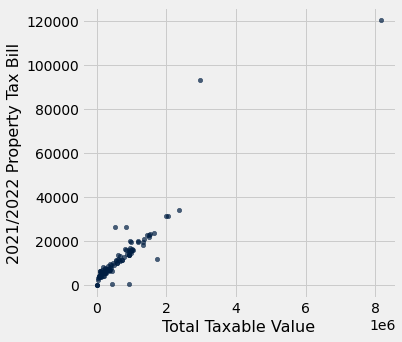

In [8]:
some_bpts_with_ttv_and_ptax_bill.scatter('Total Taxable Value', '2021/2022 Property Tax Bill')

There definitely seems to be a correlation! Let's see what it looks like without the outliers.

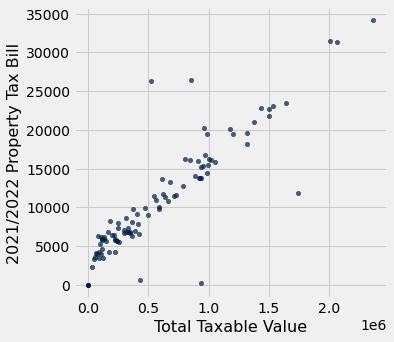

In [9]:
some_bpts_with_ttv_and_ptax_bill.where('2021/2022 Property Tax Bill', are.below(80000)).scatter('Total Taxable Value', '2021/2022 Property Tax Bill')

Because there is such a strong correlation between these two variables, we're going to base most of our data analysis off of the total taxable value of a property because our `find_ttv_for_property_with_apn` function is so much faster than our `find_21_22_bill` function. By doing this, we will be able to use larger samples without waiting as much time to find property tax data.

## Visualizing property tax data by location

Let's take a larger sample of properties in Berkeley, this time only collecting TTV.

In [10]:
larger_sample_of_properties = berkeley_properties.sample(10000, with_replacement=False)

In [3]:
start = time.time()
# to save time, we will use TTV we calculated previously
# the sample in the file below was collected using the commented out code

some_bpts_with_ttv = Table.read_table('huge_sample_of_properties_with_ttv.csv')
#some_bpts_with_ttv = larger_sample_of_properties.with_columns(
#    'Total Taxable Value',
#    larger_sample_of_properties.apply(find_ttv_for_property_with_apn, 'APN')
#)
end = time.time()
print(f'It took {end - start} seconds to process {some_bpts_with_ttv.num_rows} properties.')
print(f'{(end - start) / some_bpts_with_ttv.num_rows} seconds per property, on average.')
some_bpts_with_ttv

It took 0.05555605888366699 seconds to process 10000 properties.
5.555605888366699e-06 seconds per property, on average.


STRNBR,addr:street,APN,STRDIRECT,STRNAME,STRAPART,STRFRACT,BLDSQFTTAXABLE,@lat,@lon,Total Taxable Value
2024,Eighth Street,056 196700900,nan,EIGHTH ST,nan,nan,1796,37.8674,-122.296,934295
1715,Lincoln Street,058 216301000,nan,LINCOLN ST,nan,nan,1096,37.8766,-122.277,682348
2125,University Avenue,057 204600804,nan,UNIVERSITY AVE,nan,nan,54482,37.8724,-122.268,5.55546e+07
2121,Cedar Street,059 225902800,nan,CEDAR ST,nan,nan,619,37.8787,-122.268,114980
2525,Etna Street,055 185001901,nan,ETNA ST,nan,nan,1589,37.8649,-122.252,455801
1340,Haskell Street,052 151603200,nan,HASKELL ST,nan,nan,1878,37.8512,-122.282,56173
2620,Marin Avenue,063 296402600,nan,MARIN AVE,nan,nan,1878,37.8966,-122.262,988820
2027,Delaware Street,058 217600800,nan,DELAWARE ST,nan,nan,2808,37.8749,-122.27,1.73031e+06
1535,Oregon Street,053 167103300,nan,OREGON ST,nan,nan,1961,37.8564,-122.278,1.2042e+06
1719,Buena Avenue,059 228300800,nan,BUENA AVE,nan,nan,1813,37.8797,-122.279,823854


Now let's see how property taxes are distributed throughout the city.

In [6]:
def draw_map_with_property_taxes_colored(data_table, column_to_color='Total Taxable Value'):
    some_bpts_map_table = data_table.select(
        '@lat', '@lon'
    ).relabeled('@lat', 'lat').relabeled('@lon', 'long').with_columns(
        'labels', data_table.apply(
            lambda addr_street, strnbr: str(strnbr) + ' ' + addr_street,
            'addr:street', 'STRNBR'
        ),
        'color_scale', data_table.column(column_to_color)
    )

    return Circle.map_table(some_bpts_map_table, fill_opacity=1, line_color=None, area=20)

Here is what the distribution of property taxes looks like for all properties:

In [13]:
draw_map_with_property_taxes_colored(some_bpts_with_ttv)

It's a bit hard to tell the distribution because most properties are the same color. Let's see what it looks like for properties with TTV less than \\$1,000,000.

In [14]:
draw_map_with_property_taxes_colored(some_bpts_with_ttv.where('Total Taxable Value', are.below(1000000)))

That graph gives us some useful information. With that said, as shown in the cell below, about 23% of properties are still above \\$1,000,000. Let's see what the distribution of properties above \\$1,000,000 but less than \\$2,000,000 looks like.

In [15]:
some_bpts_with_ttv.where('Total Taxable Value', are.above(1000000)).num_rows / some_bpts_with_ttv.num_rows

0.2321

In [7]:
draw_map_with_property_taxes_colored(some_bpts_with_ttv.where('Total Taxable Value', lambda ttv: 1000000 < ttv < 2000000))

Whether it is for properties under \\$1,000,000 or for properties above \\$1,000,000, it seems that the distribution of property taxes is somewhat random. Let's see if a trend appears for the ratio of property tax to taxable square feet of floor space. We'll ignore all properties with a ratio above 1500 because there are very few of them and they shift the color spectrum.

In [8]:
# remove properties with no sqft data
some_bpts_with_ttv_and_sqft = some_bpts_with_ttv.where('BLDSQFTTAXABLE', are.not_equal_to(0))

some_bpts_with_ttv_to_sqft_ratio = some_bpts_with_ttv_and_sqft.with_columns(
    'TTV to BLDSQFTTAXABLE ratio',
    some_bpts_with_ttv_and_sqft.apply(
        lambda ttv, sqft: ttv / sqft,
        'Total Taxable Value', 'BLDSQFTTAXABLE'
    )
)

In [9]:
draw_map_with_property_taxes_colored(some_bpts_with_ttv_to_sqft_ratio.where('TTV to BLDSQFTTAXABLE ratio', are.below(1500)), column_to_color='TTV to BLDSQFTTAXABLE ratio')

From these visualizations, it seems that location (within Berkeley) has no effect on property taxes, even when controlling for square footage. To confirm, we can look at some scatterplots.

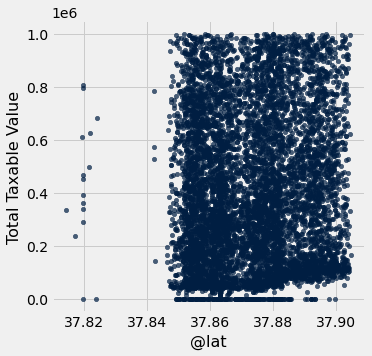

In [10]:
some_bpts_with_ttv.where('Total Taxable Value', are.below(1000000)).scatter('@lat', 'Total Taxable Value')

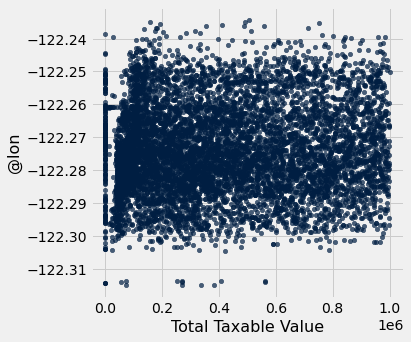

In [11]:
some_bpts_with_ttv.where('Total Taxable Value', are.below(1000000)).scatter('Total Taxable Value', '@lon')

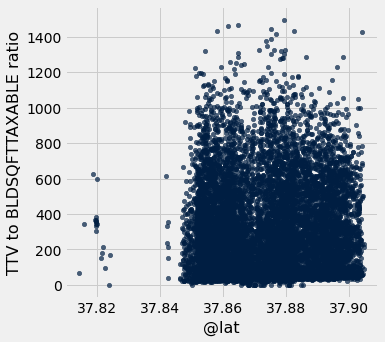

In [12]:
some_bpts_with_ttv_to_sqft_ratio.where('TTV to BLDSQFTTAXABLE ratio', are.below(1500)).scatter('@lat', 'TTV to BLDSQFTTAXABLE ratio')

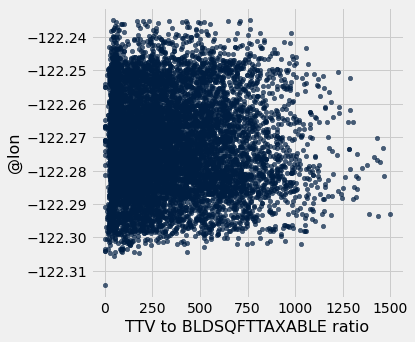

In [13]:
some_bpts_with_ttv_to_sqft_ratio.where('TTV to BLDSQFTTAXABLE ratio', are.below(1500)).scatter('TTV to BLDSQFTTAXABLE ratio', '@lon')

I'm not a professional in data analysis---especially not geographical data analysis. But from what I can tell, Berkeley seems to have evenly distributed property taxes. This project was inspired by Urban Three (specifically their revenue modeling: https://www.urbanthree.com/services/revenue-modeling/). It would be interesting to develop some 3D visuals like theirs, and to see (if they did model Berkeley, CA) what their results would look like. It also might be interesting to analyze how property taxes compare to the cost of service for different properties (like Urban Three also does: https://www.urbanthree.com/services/cost-of-service-analysis/). It could also help to look not just at Berkeley but also the surrounding area (ex. Alameda, who actually receives the property taxes) to reveal possible money sinks.

Well, that's all. I hope you found this investigation interesting in spite of the anticlimactic results!